<a href="https://colab.research.google.com/github/l8518/geot-faas/blob/main/data_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
try:
  import google.colab
  IN_COLAB = True
except:
  IN_COLAB = False

if IN_COLAB:
    from google.colab import drive
    drive.mount('/content/gdrive/')
    %cd '/content/gdrive/My Drive/Leonard Herold/Thesis/dataset'

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).
/content/gdrive/My Drive/Leonard Herold/Thesis/dataset


# Dependencies

In [56]:
import datetime

import matplotlib
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from statsmodels.tsa.seasonal import seasonal_decompose
from pandas import Series

import seaborn as sns
sns.set()

#   Data Analysis

In [6]:
dataset = pd.read_parquet('dataset.parquet')

In [7]:
# dataset.groupby( ['driver_invocation', 'provider'])['workload_invocation'].nunique()
# dataset.groupby(['local_tod'])['runtime'].agg(['count'])

coefficient_of_variation = lambda x: np.std(x, ddof=1) / np.mean(x) * 100 

## Provider Differences

In [93]:

cov_provider_df = dataset.groupby( ['provider'])['runtime'].apply(coefficient_of_variation).dropna().reset_index(name='Runtime CV').set_index(['provider'])
mean_provider_df = dataset.groupby( ['provider'])['runtime'].mean().dropna().reset_index(name='Runtime Mean').set_index(['provider'])

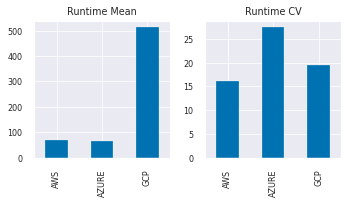

In [94]:
matplotlib.style.use('seaborn-colorblind')
# Plot Coefficient Of Variation Per Cloud Provider:
fig, axes = plt.subplots(figsize=(5,3), ncols=2, frameon=False, sharex=True)

mean_provider_df.plot(kind='bar', ax=axes[0])
axes[0].set_xlabel('')
axes[0].title.set_text('Runtime Mean')
axes[0].get_legend().remove()

cov_provider_df.plot(kind='bar', ax=axes[1])
axes[1].title.set_text('Runtime CV')
axes[1].set_xlabel('')
axes[1].get_legend().remove()

fig.tight_layout()

plt.savefig('provider_mean_cov.pdf')
plt.show()
plt.close()

## Regional Provider Differences

In [108]:
cov_provider_region_df = dataset.groupby( ['provider', 'region'])['runtime'].apply(coefficient_of_variation).dropna().reset_index(name='Runtime CV').set_index(['provider', 'region'])
mean_provider_region_df = dataset.groupby( ['provider', 'region'])['runtime'].mean().dropna().reset_index(name='Runtime Mean').set_index(['provider', 'region'])

In [124]:
provider_region_mapping = {}
for index in cov_provider_region_df.index:
  provider_region_mapping[f"({index[0]}, {index[1]})"] = index[1]

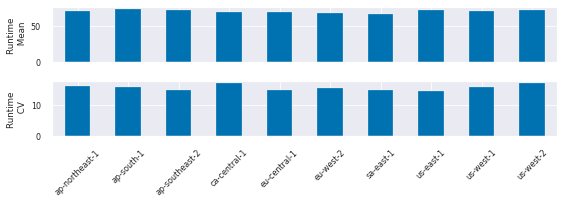

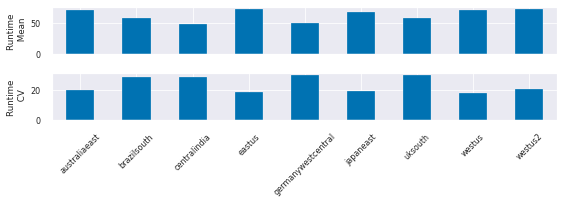

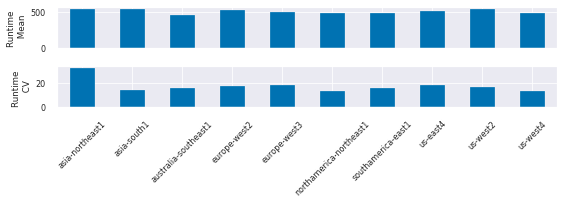

In [143]:
y_max = cov_provider_region_df['Runtime CV']
for provider in cov_provider_region_df.index.get_level_values('provider').categories:
  fig, axes = plt.subplots(figsize=(8,3), nrows=2, frameon=False, sharex=True)

  mean_provider_region_df[cov_provider_region_df.index.isin([provider], level='provider')].plot(kind='bar', ax=axes[0])
  cov_provider_region_df[cov_provider_region_df.index.isin([provider], level='provider')].plot(kind='bar', ax=axes[1])

  axes[0].set_ylabel('Runtime \n Mean')
  axes[0].get_legend().remove()


  # Set Region Names
  for tick in axes[1].get_xticklabels():
    tick.set_rotation(45)
  labels = [provider_region_mapping[tick.get_text()] for tick in axes[1].get_xticklabels()]

  axes[1].set_xticklabels(labels)

  axes[1].set_ylabel('Runtime \n CV')
  axes[1].get_legend().remove()
  axes[1].set_xlabel('')


  fig.tight_layout()

  plt.savefig(f'provider_region_mean_cov_{provider}.pdf')
  plt.show()
  plt.close()

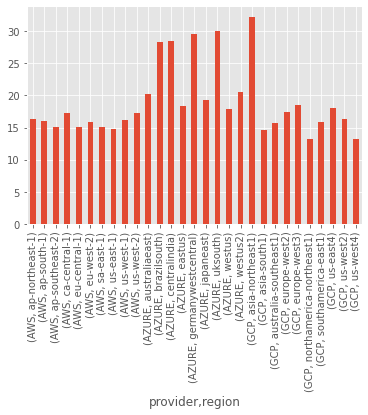

In [18]:



dataset.groupby( ['provider', 'region'])['runtime'].apply(coefficient_of_variation).dropna().plot(kind='bar')

fig, axes = plt.subplots(figsize=(30,18), nrows=3, ncols=1, sharey='all')


# Other Stuff (Experimental)

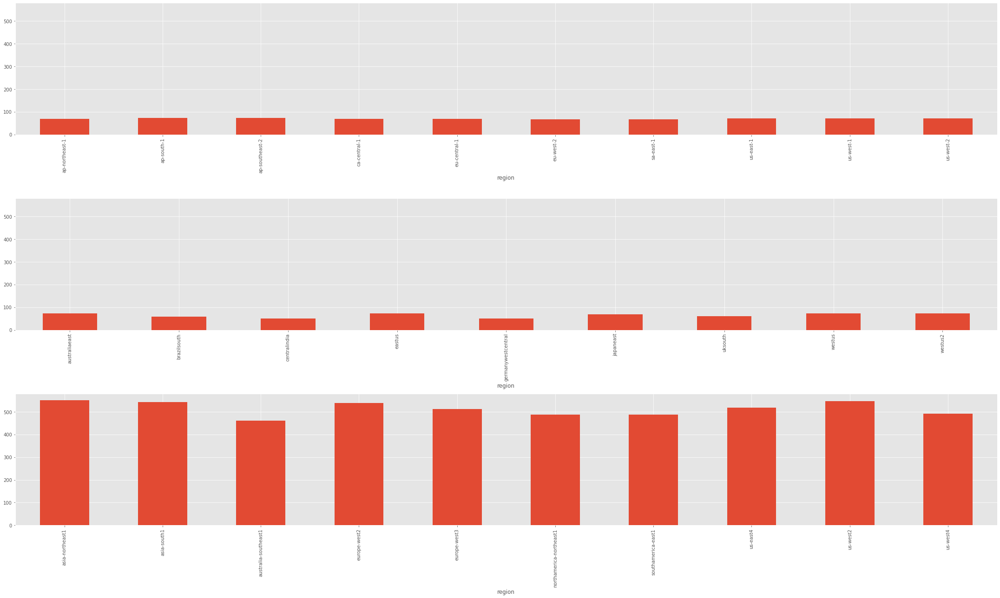

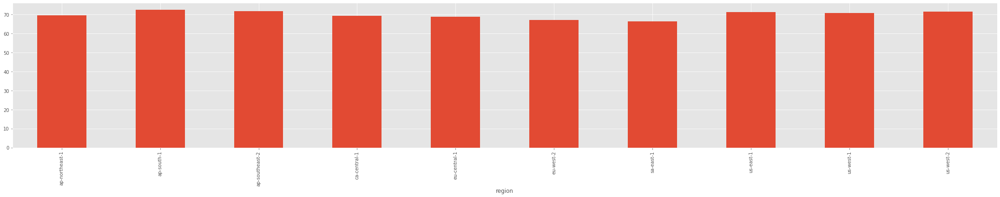

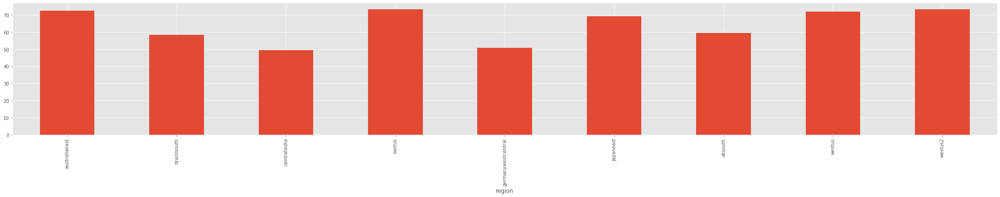

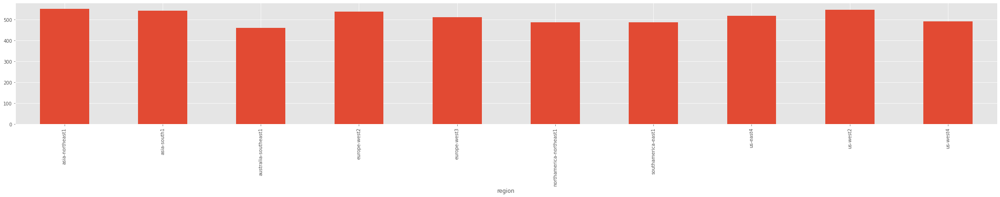

In [ ]:
fig, axes = plt.subplots(figsize=(30,18), nrows=3, ncols=1, sharey='all')
dataset[dataset['provider'] == 'AWS'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes[0])
dataset[dataset['provider'] == 'AZURE'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes[1])
dataset[dataset['provider'] == 'GCP'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes[2])

fig.tight_layout()
plt.show()
plt.close()

fig, axes = plt.subplots(figsize=(30,6))
dataset[dataset['provider'] == 'AWS'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes)
fig.tight_layout()
plt.show()
plt.close()

fig, axes = plt.subplots(figsize=(30,6))
dataset[dataset['provider'] == 'AZURE'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes)
fig.tight_layout()
plt.show()
plt.close()

fig, axes = plt.subplots(figsize=(30,6))
dataset[dataset['provider'] == 'GCP'].sort_values(['measure group']).groupby( ['region'])['runtime'].mean().dropna().plot(kind='bar', by='region', ax=axes)
fig.tight_layout()
plt.show()
plt.close()

In [ ]:


provider_regions_df = dataset[['provider', 'region']].value_counts().reset_index(name='count')

In [ ]:
def plot_mean_col(dataset, provider, region, col):
    provider_df = dataset[dataset['provider'] == provider]
    provider_region_df = provider_df[provider_df['region'] == region]
    mean_latency_df = provider_region_df.groupby(['driver_invocation'])[col].mean()
    
    fig, ax = plt.subplots(figsize=(220,6))
    mean_latency_df.plot(title=f'{provider} {region} mean {col}', style='.-')

    hours = mdates.MinuteLocator(byminute=[0,30]) #or use interval

    hours.MAXTICKS = 1500

    h_fmt = mdates.DateFormatter('%a %H')


    ax.xaxis.set_major_locator(hours)
    ax.xaxis.set_major_formatter(h_fmt)

    fig.autofmt_xdate()

    plt.xticks(rotation=90)
    plt.show()
    plt.close()

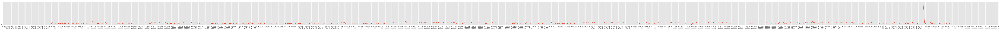

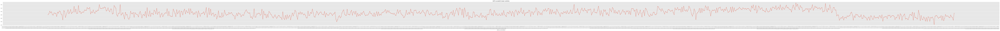

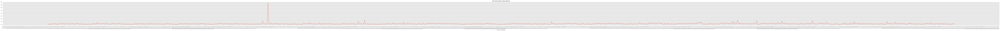

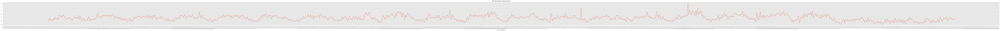

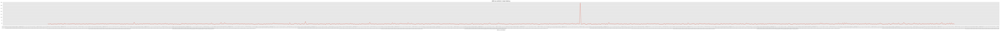

...

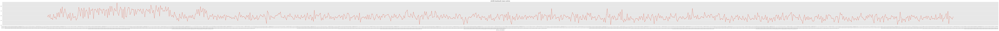

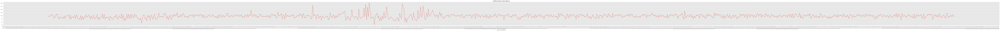

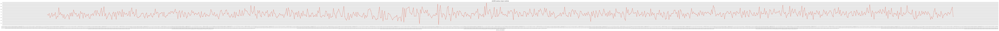

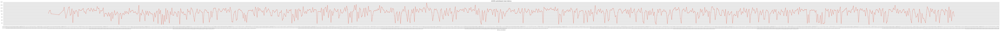

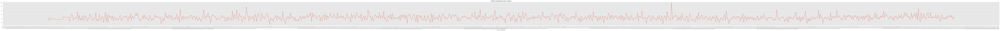

In [ ]:
for index, row in provider_regions_df.iterrows():
    provider = row['provider']
    region =  row['region']
    plot_mean_col(dataset, provider, region, 'latency')
    plot_mean_col(dataset, provider, region, 'runtime')


In [ ]:
unique_cpu_models = dataset.groupby(['provider'])['cpuModel'].nunique()
unique_vendors = dataset.groupby(['provider'])['vendorId'].nunique()

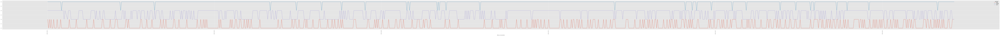

In [ ]:
fig, ax = plt.subplots(figsize=(240,8))
dataset.groupby(['driver_invocation', 'provider'])['cpuType'].nunique().unstack().plot(ax=ax, kind='line')

plt.xticks(rotation=90)
plt.show()
plt.close()

In [ ]:
region = 'sa-east-1'
provider = 'AWS'

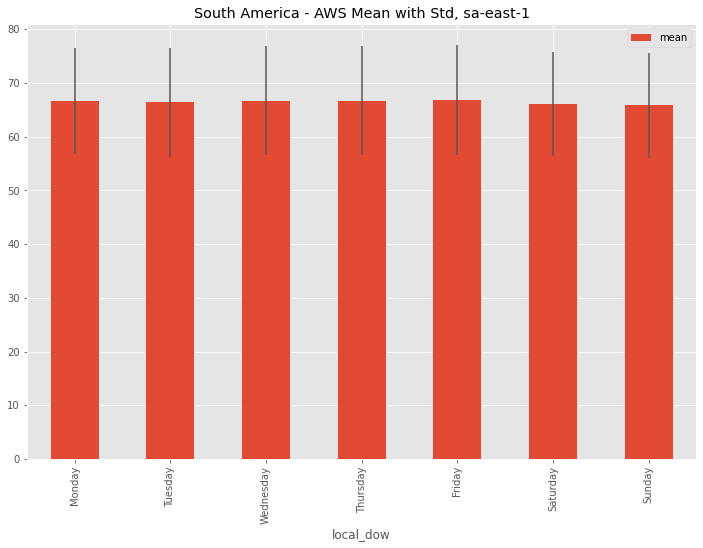

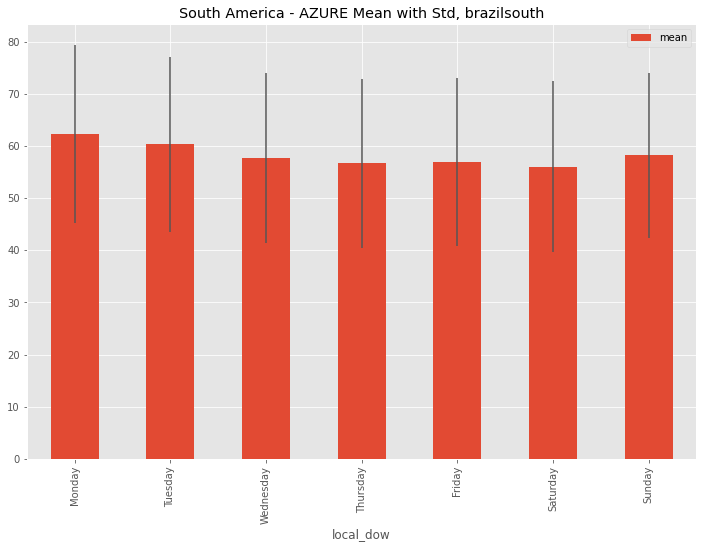

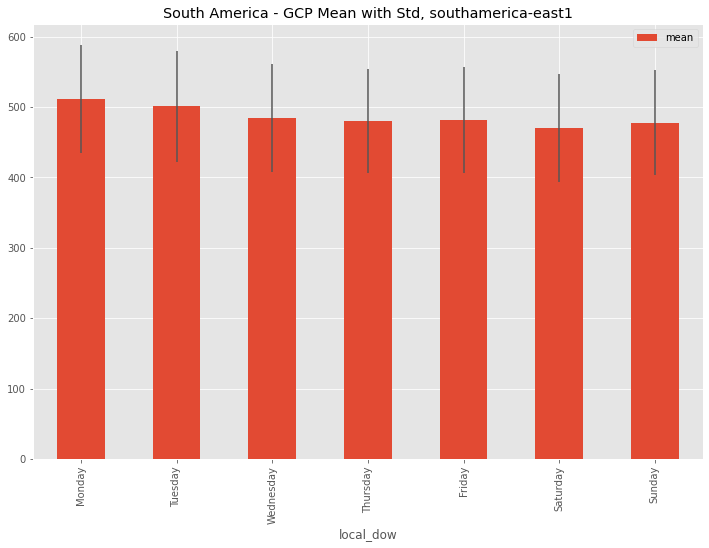

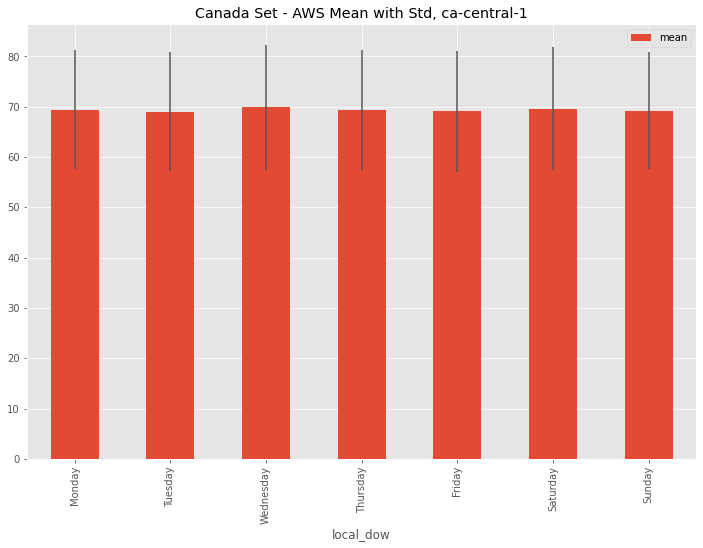

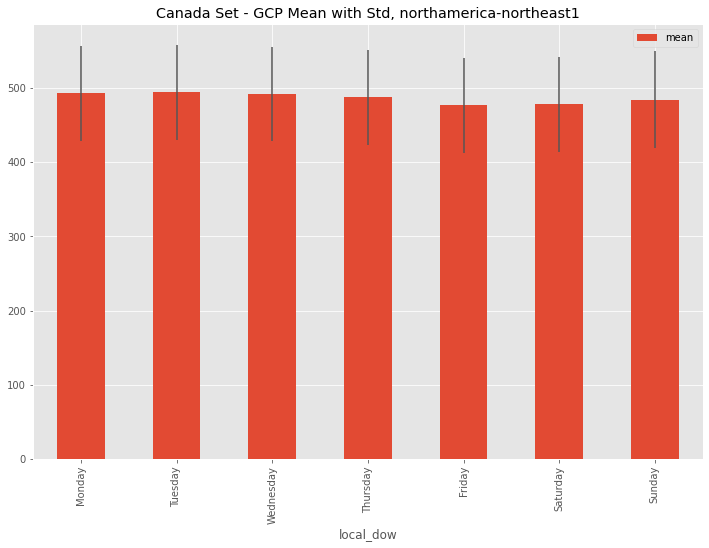

...

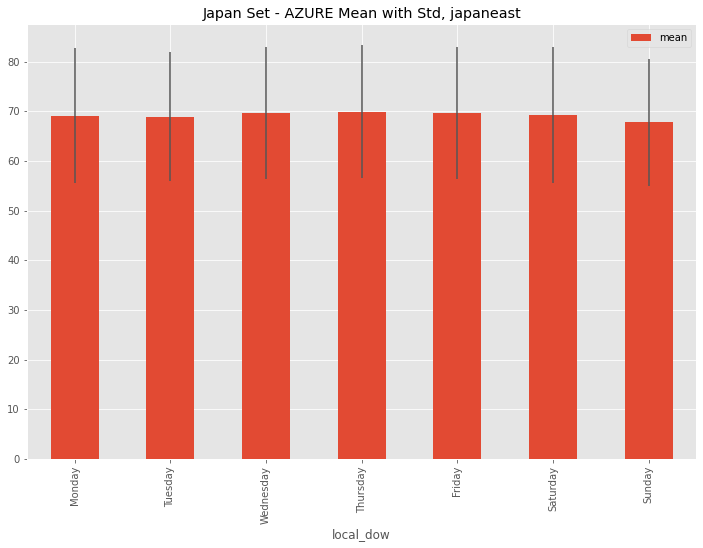

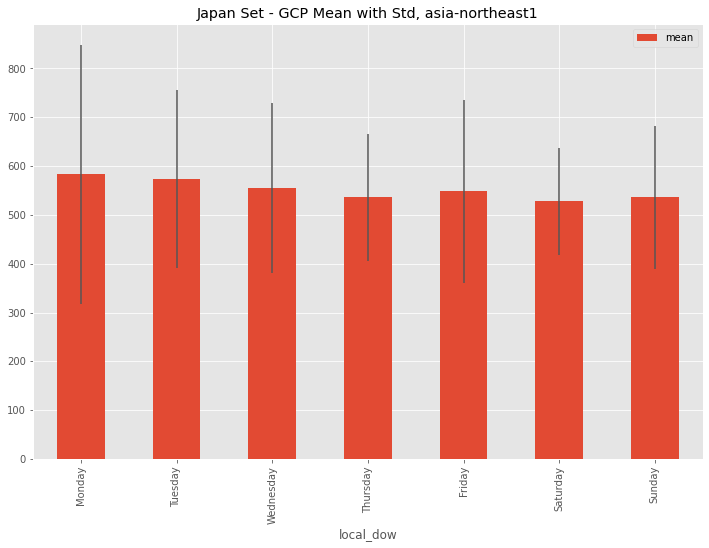

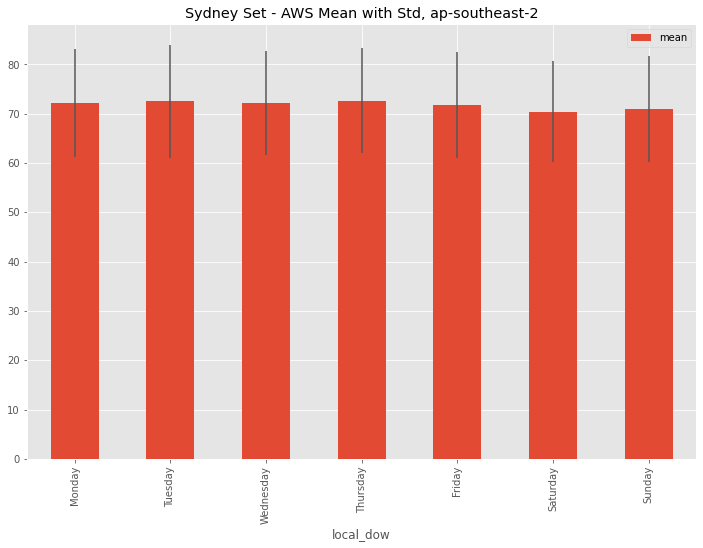

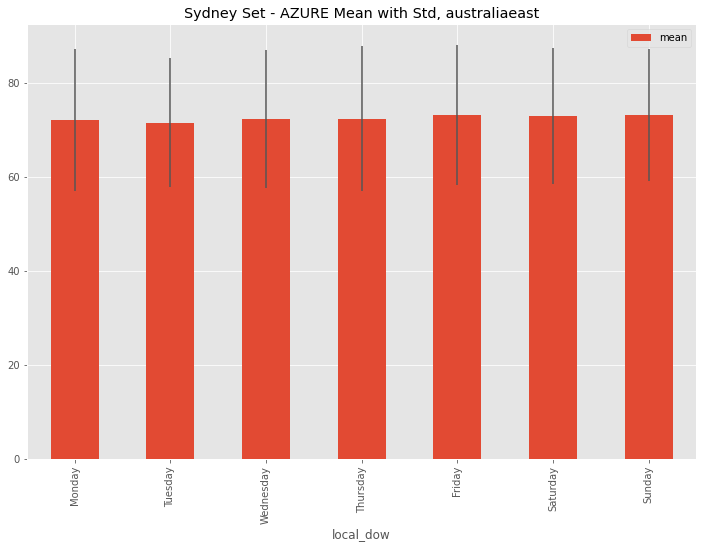

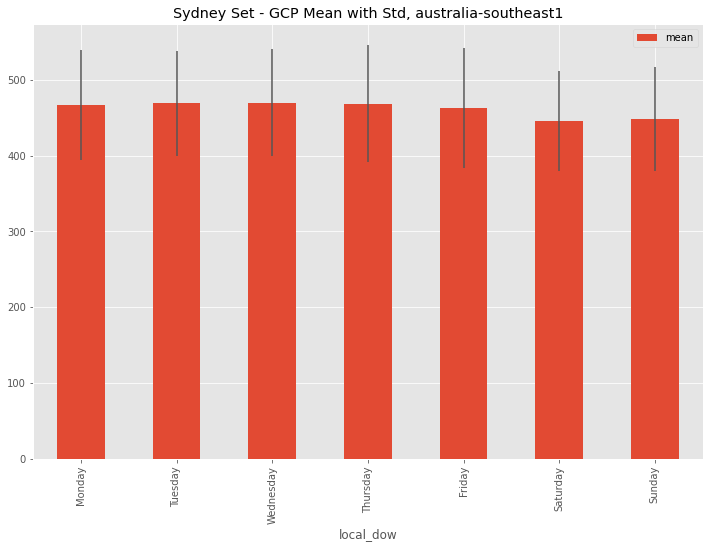

In [ ]:
for mg in measure_groups:
  for provider in measure_groups[mg]['providers']:
    regions = measure_groups[mg]['providers'][provider]
    if len(regions) > 0:
      
      for region in regions:
        fig, ax = plt.subplots(figsize=(12,8))
        df = dataset[ (dataset['region'] == region) & (dataset['provider'] == provider)]
        df.groupby(['local_dow'])['runtime'].agg(['mean', 'std']).loc[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']].plot(title=f'{mg} - {provider} Mean with Std, {region}', kind='bar', yerr='std', ax=ax)

        plt.show()
        plt.close()

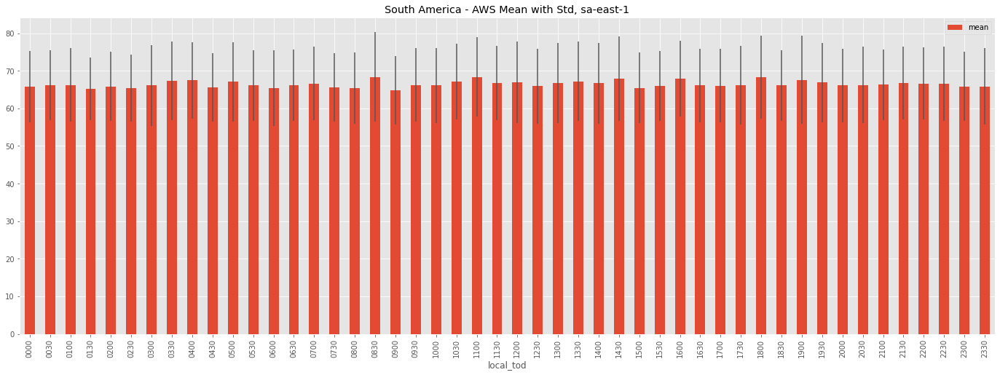

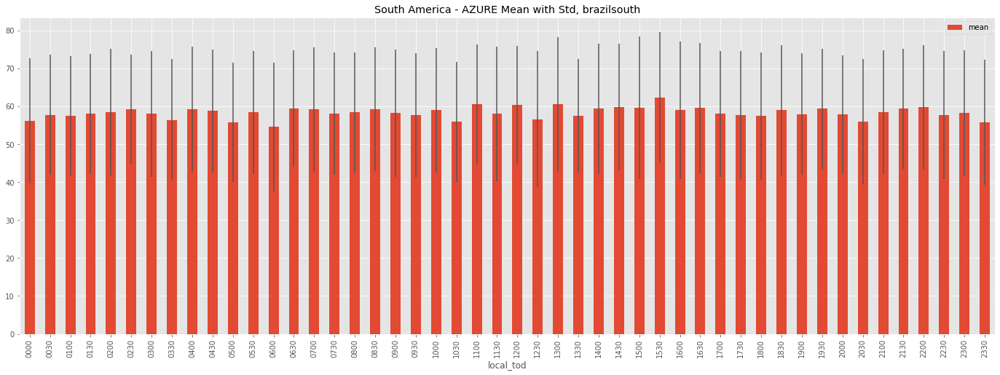

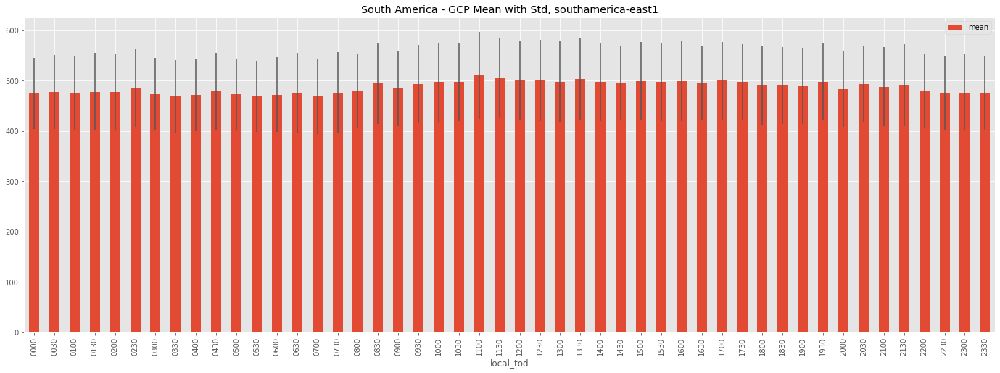

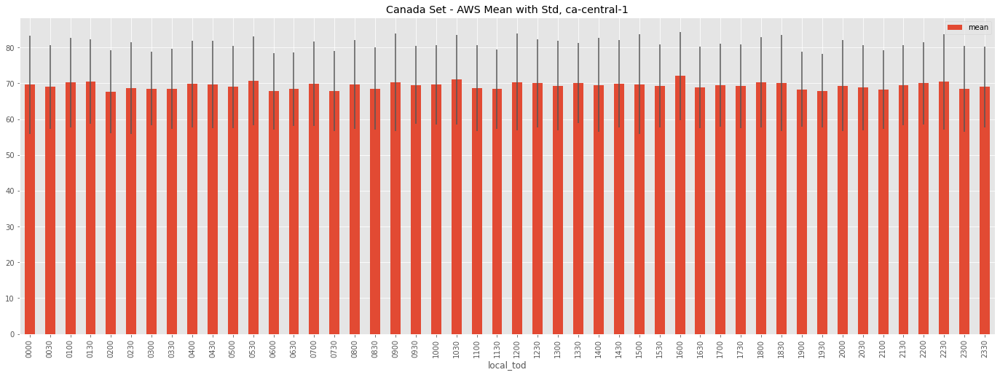

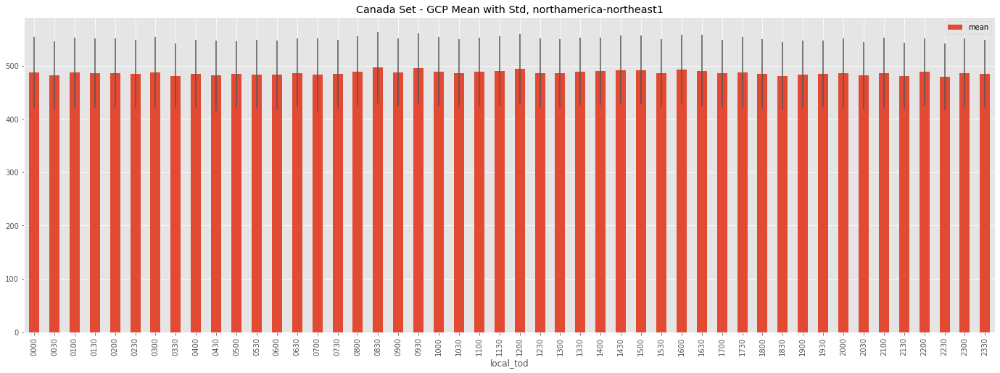

...

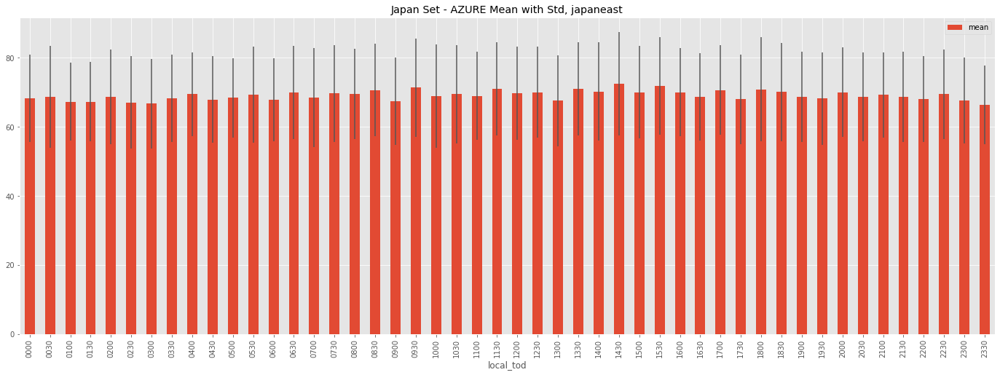

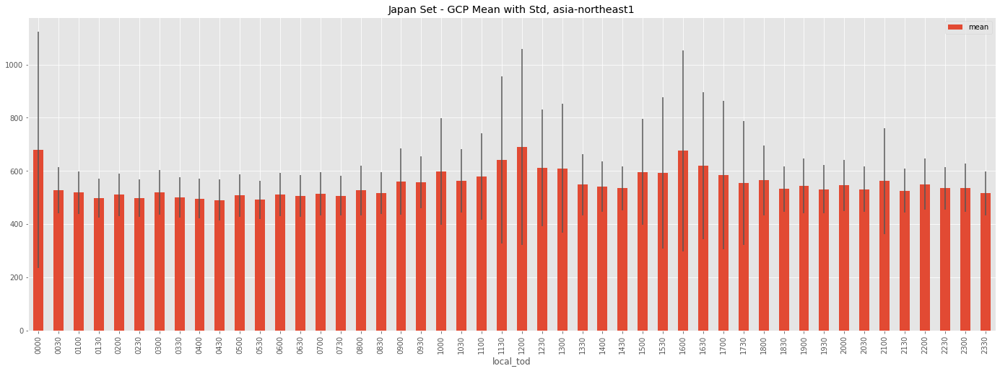

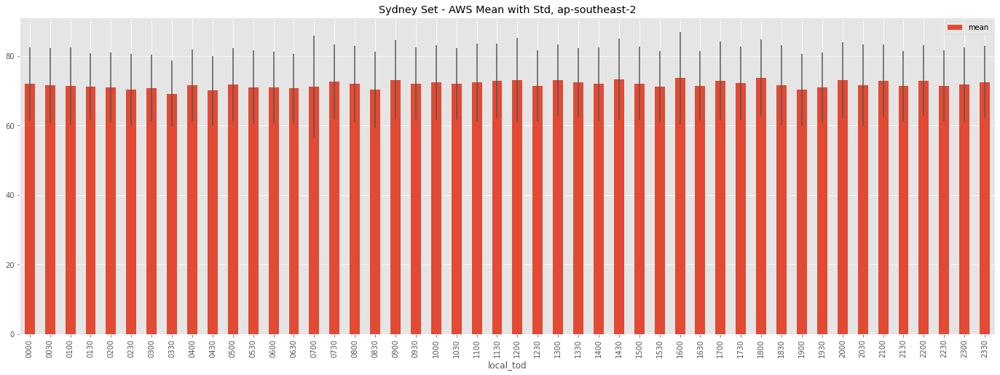

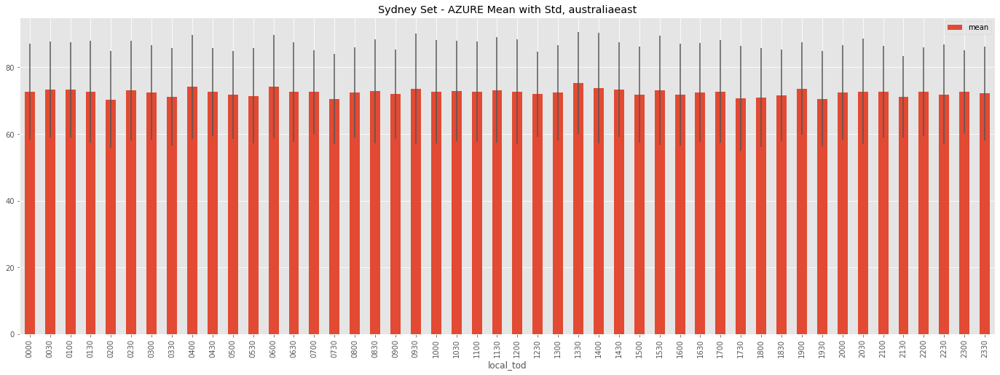

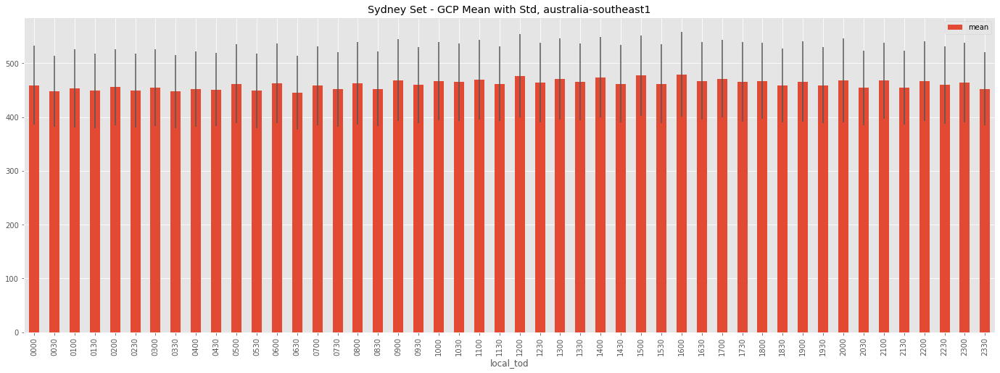

In [ ]:
mgs = measure_groups.keys()
for mg in mgs:
  for provider in measure_groups[mg]['providers']:
    regions = measure_groups[mg]['providers'][provider]
    if len(regions) > 0:
      
      for region in regions:
        fig, ax = plt.subplots(figsize=(24,8))
        df = dataset[ (dataset['region'] == region) & (dataset['provider'] == provider)]
        df.groupby(['local_tod'])['runtime'].agg(['mean', 'std']).plot(title=f'{mg} - {provider} Mean with Std, {region}', kind='bar', yerr='std', ax=ax)
        plt.show()
        plt.close()

In [ ]:
def get_average_responses_per_region_and_local_tod(dataset):
  df = dataset.groupby(['region', 'local_tod'])[ ['driver_invocation'] ].agg(['count', 'nunique'])
  return (df[ ('driver_invocation', 'count') ] / df[ ('driver_invocation', 'nunique') ]).reset_index(name ='Average Responses')
avg_reponses_df = get_average_responses_per_region_and_local_tod(dataset)
avg_reponses_df = avg_reponses_df.set_index('local_tod')

In [ ]:
measure_group_region_df = dataset.groupby('measure group')['region'].unique()
for mg in measure_group_region_df.index:
    regions = measure_group_region_df.loc[mg]
    for region in regions:
        fig, ax = plt.subplots(figsize=(24,8))
        df = avg_reponses_df[avg_reponses_df['region'] == region]
        df.plot(title=f'{mg} Mean with Std, {region}', kind='bar',  ax=ax)
        plt.show()
        plt.close()

In [ ]:
def decompose(dataset, provider, region):
  df = dataset[ (dataset['provider'] == provider) & (dataset['region'] == region) ].groupby(['driver_invocation'])[['runtime']].mean()
  with plt.rc_context():
      plt.rc("figure", figsize=(20,8))
      result = seasonal_decompose(df, model='additive', freq=48)
      
      fig, axis = plt.subplots(figsize=(24,12), sharex=True, nrows=4)

      axis[0].plot(result.observed)
      plt.setp(axis[0], ylabel='Observed')

      axis[1].plot(result.resid)
      plt.setp(axis[1], ylabel='Residuals')

      axis[2].plot(result.trend)
      plt.setp(axis[2], ylabel='Trend')

      axis[3].plot(result.seasonal)
      plt.setp(axis[3], ylabel='Seasonal')

      hours = mdates.HourLocator(interval=12) #or use interval
      hours.MAXTICKS = 1500

      h_fmt = mdates.DateFormatter('%a %H')

      axis[0].xaxis.set_major_locator(hours)
      axis[0].xaxis.set_major_formatter(h_fmt)

      axis[1].xaxis.set_major_locator(hours)
      axis[1].xaxis.set_major_formatter(h_fmt)

      axis[2].xaxis.set_major_locator(hours)
      axis[2].xaxis.set_major_formatter(h_fmt)

      axis[3].xaxis.set_major_locator(hours)
      axis[3].xaxis.set_major_formatter(h_fmt)

      fig.autofmt_xdate()

      fig.suptitle(f"Decomposition for {provider} - {region}")

      plt.show()
      plt.close()

      return result

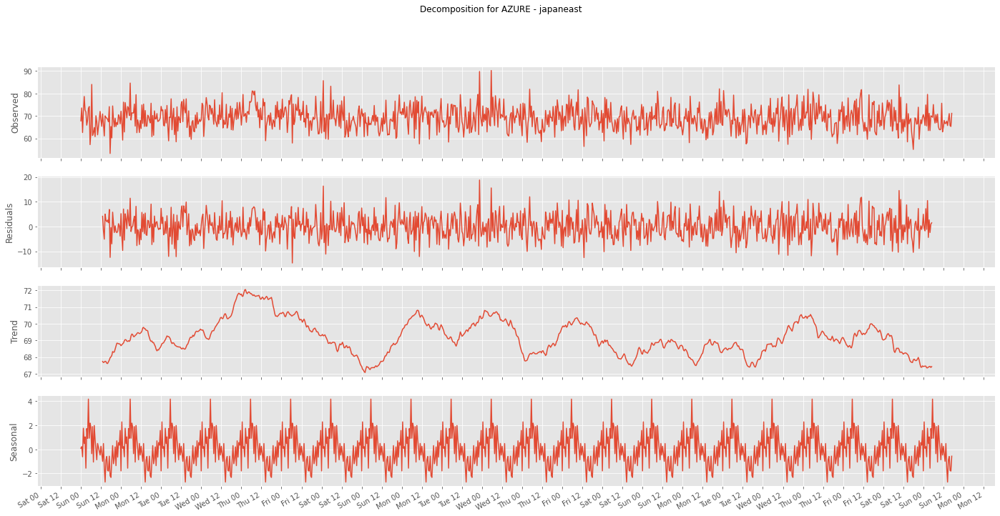

In [ ]:
result = decompose(dataset, 'AZURE', 'japaneast')

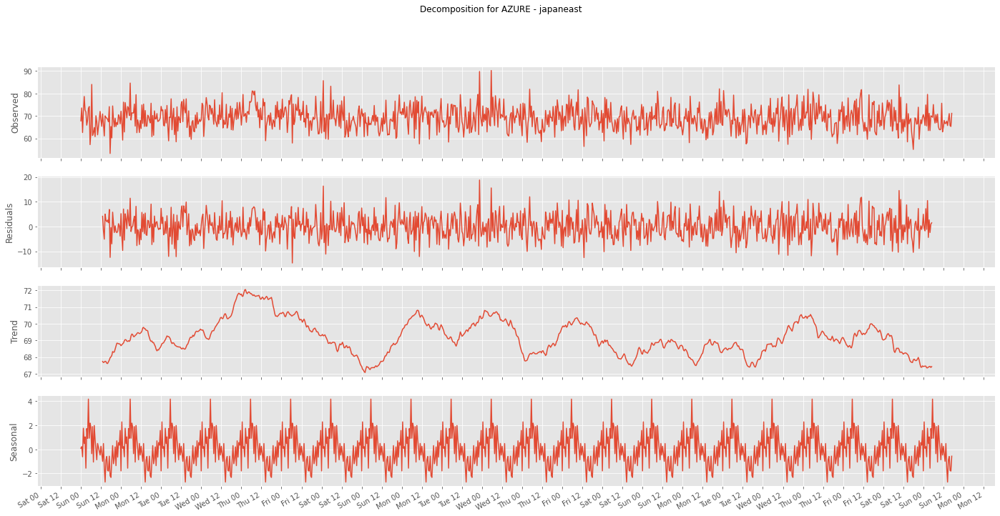

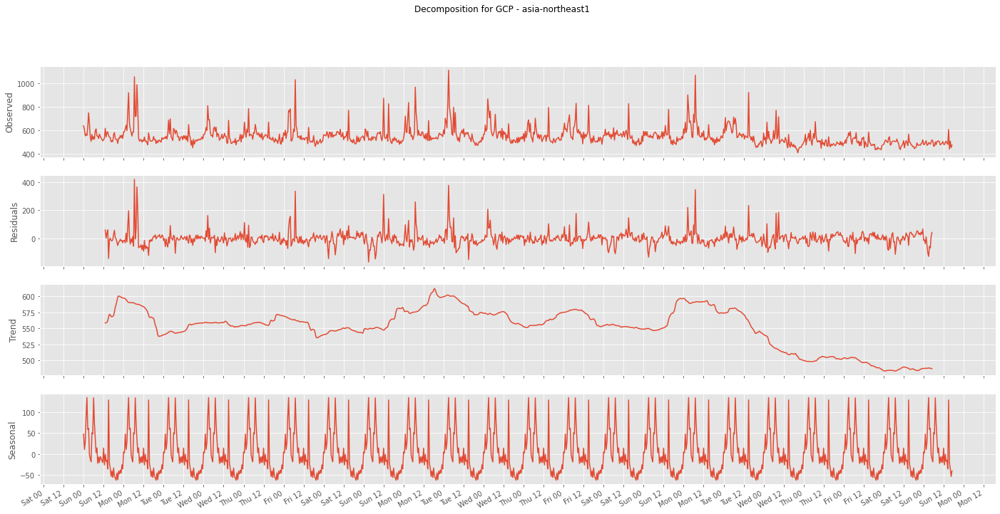

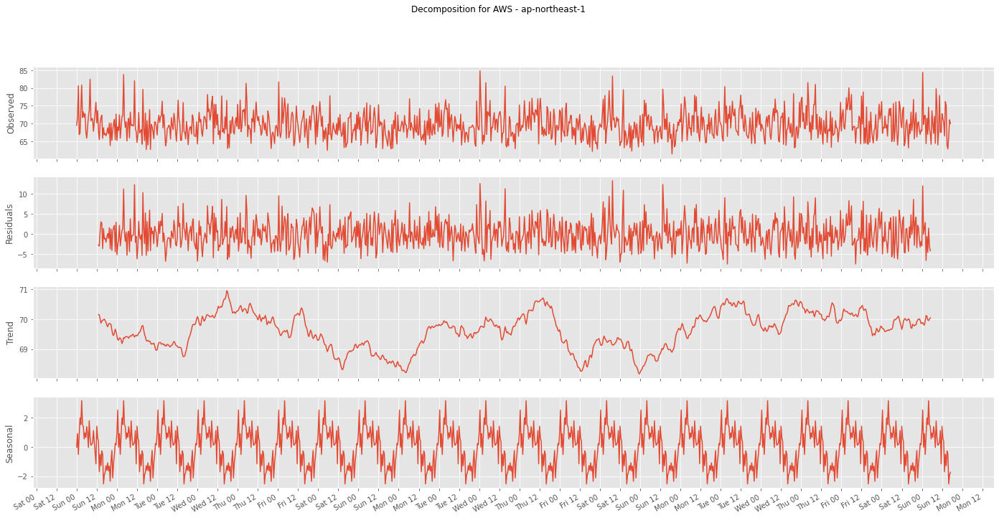

In [ ]:
decompose(dataset, 'AZURE', 'japaneast')
decompose(dataset, 'GCP', 'asia-northeast1')
decompose(dataset, 'AWS', 'ap-northeast-1')

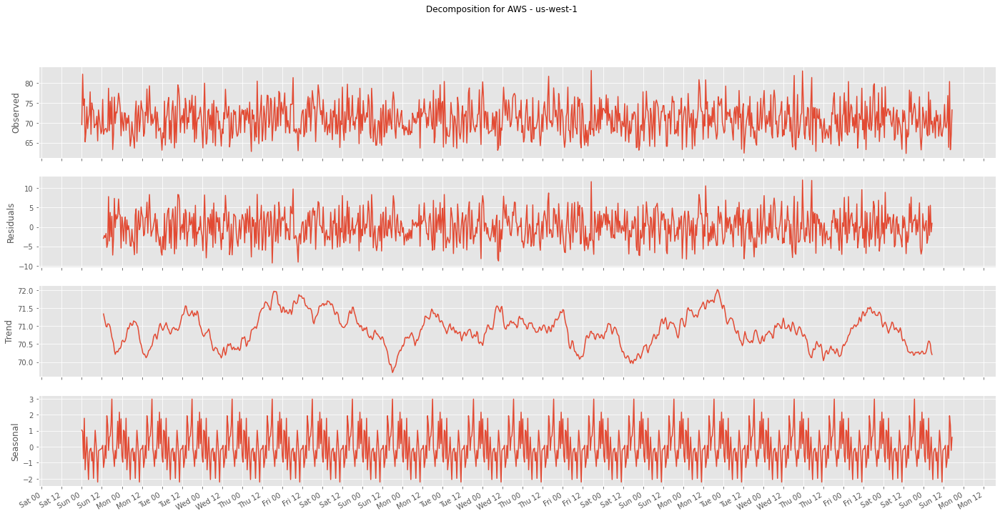

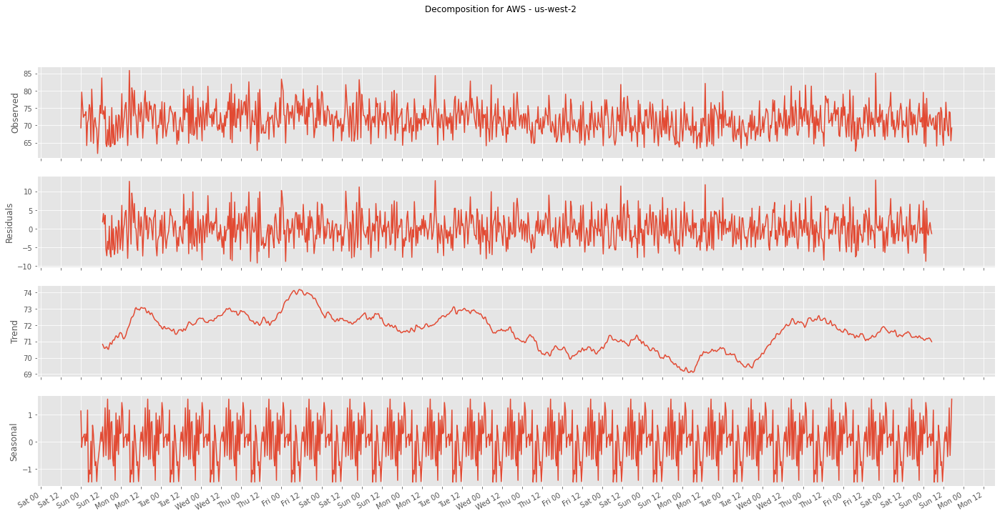

In [ ]:
decompose(dataset, 'AWS', 'us-west-1')
decompose(dataset, 'AWS', 'us-west-2')

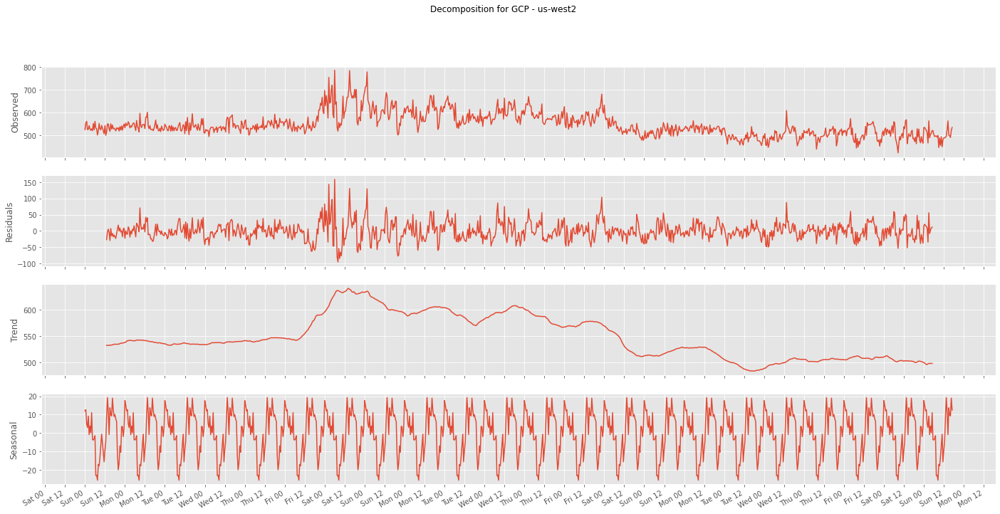

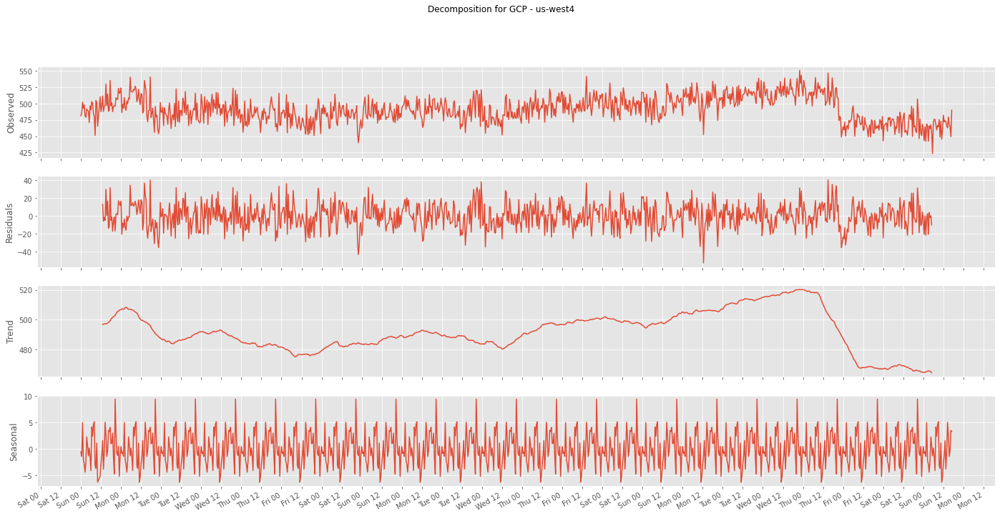

In [ ]:
decompose(dataset, 'GCP', 'us-west2')
decompose(dataset, 'GCP', 'us-west4')